In [175]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# models n stiff 
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

# for GEO spacial 
import geopandas as gpd
from descartes import PolygonPatch

# linking to google drive
import requests
from io import StringIO

 


### Input File 

In [176]:
"""https://drive.google.com/file/d/18Ba-FkxLf-Mlikuy_UaTa9WZwUZ2hLtx/view?usp=sharing

url = requests.get('https://doc-0g-78-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/5otus4mg51j69f99n47jgs0t374r46u3/1560607200000/09837260612050622056/*/0B6GhBwm5vaB2ekdlZW5WZnppb28?e=download')

csv_raw = StringIO(url.text)
dfs = pd.read_csv(csv_raw)
"""

"https://drive.google.com/file/d/18Ba-FkxLf-Mlikuy_UaTa9WZwUZ2hLtx/view?usp=sharing\n\nurl = requests.get('https://doc-0g-78-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/5otus4mg51j69f99n47jgs0t374r46u3/1560607200000/09837260612050622056/*/0B6GhBwm5vaB2ekdlZW5WZnppb28?e=download')\n\ncsv_raw = StringIO(url.text)\ndfs = pd.read_csv(csv_raw)\n"

In [177]:
df = pd.read_csv('./data/Motor_Vehicle_Collisions_-_Crashes.csv')

/Users/metamorphosis/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


## Basic look at the file

In [178]:
df.shape

(1720022, 29)

In [179]:
df.sample(3)

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
796789,11/23/2016,8:15,NaN,NaN,40.714333,-73.929460,"(40.714333, -73.92946)",METROPOLITAN AVENUE,VARICK AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,3566938,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN
389713,08/01/2018,10:30,NaN,NaN,40.872322,-73.906590,"(40.872322, -73.90659)",MAJOR DEEGAN EXPRESSWAY,NaN,NaN,...,Unspecified,NaN,NaN,NaN,3952958,Sedan,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN
1493618,08/17/2013,5:36,BROOKLYN,11211,40.709552,-73.958859,"(40.7095517, -73.9588589)",SOUTH 5 STREET,HAVEMEYER STREET,NaN,...,Unspecified,NaN,NaN,NaN,196637,SPORT UTILITY / STATION WAGON,PASSENGER VEHICLE,NaN,NaN,NaN


In [180]:
# crash date create day of the week 

# crash time of day 24 cycle

# collision

# Borough

--- 

#### Checking Completness of Location Data

In [181]:
# total data count 
df.shape

(1720022, 29)

In [182]:
# don't have location info 
df['LOCATION'].isna().sum()

205510

In [183]:
# Don't have a longitude info 
df['LONGITUDE'].isna().sum()

205510

In [184]:
# Don't have a street name
df['ON STREET NAME'].isna().sum()

343816

In [185]:
# don't have a street name or location GPS
((df['ON STREET NAME'].isna() == True) & (df['LOCATION'].isna() == True)).sum()

52949

In [186]:
# Don't have a location, but DOES have a street name & DOES have a cross street 
((df['ON STREET NAME'].isna() == False) & (df['LOCATION'].isna() == True) & (df['CROSS STREET NAME'].isna() == False)).sum()

128262

In [187]:
df[(df['ON STREET NAME'].isna() == False)].sample(3)

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
1079922,08/17/2015,17:25,STATEN ISLAND,10310,40.640569,-74.117992,"(40.640569, -74.1179917)",RICHMOND TERRACE,BROADWAY,NaN,...,Unspecified,NaN,NaN,NaN,3280155,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN
691250,04/27/2017,11:20,QUEENS,11357,40.789368,-73.811530,"(40.789368, -73.81153)",CLINTONVILLE STREET,14 AVENUE,NaN,...,NaN,NaN,NaN,NaN,3658383,NaN,NaN,NaN,NaN,NaN
385498,08/03/2018,17:00,MANHATTAN,10018,40.756450,-74.001510,"(40.75645, -74.00151)",WEST 35 STREET,11 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,3955947,Sedan,NaN,NaN,NaN,NaN


---

# Cleaning 

In [188]:
df_clean = df.copy()  #[(df['LONGITUDE'].isna())]

In [189]:
# Removing NaNs from  ['LATITUDE','LONGITUDE']  row 
df_clean= df_clean.dropna(subset=['LATITUDE','LONGITUDE'])

### Cleaning outliners in 'LONGITUDE' & 'LATITUDE'

In [190]:
df_clean = df_clean[(df_clean['LONGITUDE'] != 0)]  # 1271

In [191]:
df_clean = df_clean[(df_clean['LONGITUDE'] > -200)] #.sum() 106 rows @ -201.23706

In [192]:
df_clean = df_clean[(df_clean['LATITUDE'] > 38)] #.sum() # 2 @ 35N

In [193]:
df_clean = df_clean[(df_clean['LONGITUDE'] < -50)] # .sum() # 19 > -50 long

In [194]:
df_clean = df_clean[(df_clean['LONGITUDE'] > -74.6)] # .sum() # 5 < -74.6

In [195]:
df_clean = df_clean[(df_clean['LATITUDE'] < 41)] #.sum() # > 41

#### Number of data points

In [196]:
df_clean.shape

(1513092, 29)

In [197]:
df_clean.head(3)

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,10/09/2020,10:12,NaN,NaN,40.683933,-73.871190,"(40.683933, -73.87119)",HEMLOCK STREET,NaN,NaN,...,NaN,NaN,NaN,NaN,4356254,NaN,NaN,NaN,NaN,NaN
3,10/08/2020,10:46,NaN,NaN,40.827210,-73.920700,"(40.82721, -73.9207)",EAST 162 STREET,NaN,NaN,...,Unspecified,NaN,NaN,NaN,4355967,Sedan,AMBU,NaN,NaN,NaN
4,10/08/2020,19:24,NaN,NaN,40.799310,-73.943245,"(40.79931, -73.943245)",PARK AVENUE,NaN,NaN,...,NaN,NaN,NaN,NaN,4356130,Sedan,NaN,NaN,NaN,NaN


---

---

### GeoSpatial conversion 

In [208]:
# creates geo data for crash data

df_clean = gpd.GeoDataFrame(
                df_clean, geometry=gpd.points_from_xy(df_clean.LONGITUDE, df_clean.LATITUDE))

--- 

## TimeSeries conversion 

In [209]:
df_clean['date'] = df_clean['CRASH DATE'] + ' ' + df_clean['CRASH TIME']

In [210]:
df_clean['date'] = pd.to_datetime(df_clean['date'])

In [219]:
df_clean['date_2']  = df_clean['date']

In [220]:
df_clean.set_index('date', inplace=True)

In [222]:
df_clean.sort_index(inplace=True)

In [226]:
# Create data frame for 2018

df_2018 = df_clean.loc['2018']
df_2018.shape

(216106, 32)

---

## Hyper peramter

In [228]:
df_clean['TIME HR'] = [time.split(':')[0] for time in df_clean['CRASH TIME'] ]

--- 

## OutPuting files

In [231]:
df_2018.to_csv('../crash_dummies/clean_data/crash_features_2018.csv',index = True )

In [230]:
df_clean.to_csv('../crash_dummies/data/crash_features_clean.csv', index = False)

---

# EDA

In [216]:
df_clean['date'].dt.month

0          10
3          10
4          10
6          10
7          10
           ..
1720017     7
1720018     7
1720019     7
1720020     7
1720021     7
Name: date, Length: 1513092, dtype: int64

In [165]:
df_clean.sample(3)

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,date,TIME HR
1102135,07/07/2015,23:30,QUEENS,11385,40.708554,-73.839012,"(40.7085545, -73.8390125)",FOREST PARK DRIVE,METROPOLITAN AVENUE,NaN,...,NaN,NaN,3254517,SPORT UTILITY / STATION WAGON,PASSENGER VEHICLE,NaN,NaN,NaN,2015-07-07 23:30:00,23
469124,04/13/2018,16:52,BRONX,10468,40.862778,-73.906166,"(40.862778, -73.906166)",WEST FORDHAM ROAD,ANDREWS AVENUE,NaN,...,NaN,NaN,3880383,Sedan,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,2018-04-13 16:52:00,16
813619,10/13/2016,23:00,BROOKLYN,11203,40.651104,-73.943810,"(40.651104, -73.94381)",CHURCH AVENUE,BROOKLYN AVENUE,NaN,...,NaN,NaN,3542271,Sedan,Bike,NaN,NaN,NaN,2016-10-13 23:00:00,23


### CONTRIBUTING FACTOR VEHICLE 1

In [166]:
df_clean['CONTRIBUTING FACTOR VEHICLE 1'].value_counts()[:40]

Unspecified                                              541500
Driver Inattention/Distraction                           293225
Failure to Yield Right-of-Way                             89469
Following Too Closely                                     76302
Backing Unsafely                                          59656
Other Vehicular                                           47945
Passing or Lane Usage Improper                            38063
Fatigued/Drowsy                                           37376
Turning Improperly                                        36884
Passing Too Closely                                       36108
Unsafe Lane Changing                                      28957
Traffic Control Disregarded                               23500
Driver Inexperience                                       22628
Lost Consciousness                                        16824
Alcohol Involvement                                       14761
Unsafe Speed                            

In [204]:
"""
    Creating columns fore each of the contributing factor over 10_000

"""


#Creates a list of contributting factors

contributting_factor_list = df_clean['CONTRIBUTING FACTOR VEHICLE 1'].unique()[1:]
contributting_factor_list
# Loop to create list of contributing factors with over 9000 entries 

contributting_factor_list_9000 = []
for factor in contributting_factor_list:
    if df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == factor)]['COLLISION_ID'].count() > 9_000: 
            contributting_factor_list_9000.append(factor)
           
            
            

In [168]:
contributting_factor_list_9000

['Failure to Yield Right-of-Way',
 'Driver Inexperience',
 'Driver Inattention/Distraction',
 'Unspecified',
 'Alcohol Involvement',
 'Passing or Lane Usage Improper',
 'Following Too Closely',
 'Passing Too Closely',
 'Traffic Control Disregarded',
 'Unsafe Speed',
 'Unsafe Lane Changing',
 'Lost Consciousness',
 'Oversized Vehicle',
 'Backing Unsafely',
 'Pavement Slippery',
 'Turning Improperly',
 'View Obstructed/Limited',
 'Other Vehicular',
 'Reaction to Uninvolved Vehicle',
 'Outside Car Distraction',
 'Fatigued/Drowsy',
 'Prescription Medication']

In [169]:
#df_clean.plot.bar(x = 'CONTRIBUTING FACTOR VEHICLE 1')

In [170]:

#df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] in contributting_factor_list_9000)].value_counts().plot.bar()


---

---

### EDA using a smampled subset

In [171]:
df_clean_s = df_clean.sample(10_000)

In [172]:
df_clean_s.head(1)

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,date,TIME HR
891232,06/10/2016,23:10,QUEENS,11434,40.65616,-73.76736,"(40.65616, -73.76736)",ROCKAWAY BOULEVARD,BREWER BOULEVARD,NaN,...,NaN,NaN,3459872,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,2016-06-10 23:10:00,23


--- 

## Reducing features

In [207]:
"""
    Creating reduced colums 

"""
# list of columns names

columns_names = list(df_clean.columns)
columns_names

['CRASH DATE',
 'CRASH TIME',
 'BOROUGH',
 'ZIP CODE',
 'LATITUDE',
 'LONGITUDE',
 'LOCATION',
 'ON STREET NAME',
 'CROSS STREET NAME',
 'OFF STREET NAME',
 'NUMBER OF PERSONS INJURED',
 'NUMBER OF PERSONS KILLED',
 'NUMBER OF PEDESTRIANS INJURED',
 'NUMBER OF PEDESTRIANS KILLED',
 'NUMBER OF CYCLIST INJURED',
 'NUMBER OF CYCLIST KILLED',
 'NUMBER OF MOTORIST INJURED',
 'NUMBER OF MOTORIST KILLED',
 'CONTRIBUTING FACTOR VEHICLE 1',
 'CONTRIBUTING FACTOR VEHICLE 2',
 'CONTRIBUTING FACTOR VEHICLE 3',
 'CONTRIBUTING FACTOR VEHICLE 4',
 'CONTRIBUTING FACTOR VEHICLE 5',
 'COLLISION_ID',
 'VEHICLE TYPE CODE 1',
 'VEHICLE TYPE CODE 2',
 'VEHICLE TYPE CODE 3',
 'VEHICLE TYPE CODE 4',
 'VEHICLE TYPE CODE 5']

#removing names of columns you want to KEEP

columns_names.remove('LATITUDE')
columns_names.remove('LONGITUDE')
columns_names.remove('CONTRIBUTING FACTOR VEHICLE 1')
columns_names.remove('CRASH TIME')
columns_names.remove('CRASH DATE')
#dropping the rest of the list 

df_sm_features = df_clean.drop(columns = columns_names, axis = 1)

---

In [67]:
df_clean[44:55].T

,132,133,137,140,143,146,150,152,153,154,163
CRASH DATE,08/18/2020,08/18/2020,08/17/2020,08/14/2020,08/13/2020,08/12/2020,08/11/2020,08/10/2020,08/10/2020,08/10/2020,08/08/2020
CRASH TIME,16:00,8:30,6:30,10:15,13:18,19:00,17:39,12:25,14:40,17:40,3:45
BOROUGH,BROOKLYN,NaN,NaN,BROOKLYN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZIP CODE,11225,NaN,NaN,11229,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LATITUDE,40.6635,40.7051,40.7399,40.5992,40.6666,40.6852,40.674,40.6111,40.5733,40.8142,40.6772
LONGITUDE,-73.9567,-74.0165,-73.8458,-73.9534,-73.8118,-73.9783,-73.7345,-74.1147,-74.0026,-73.9343,-73.9248
LOCATION,"(40.663544, -73.95671)","(40.70509, -74.016464)","(40.739933, -73.84579)","(40.599174, -73.95339)","(40.666573, -73.811775)","(40.685196, -73.97829)","(40.674026, -73.73447)","(40.611095, -74.11467)","(40.573326, -74.002556)","(40.81417, -73.93431)","(40.677174, -73.924774)"
ON STREET NAME,NaN,BATTERY PLACE,LONG ISLAND EXPRESSWAY,NaN,BELT PARKWAY,FLATBUSH AVENUE,LAURELTON PARKWAY,STATEN ISLAND EXPRESSWAY,WEST 37 STREET,HARLEM RIVER DRIVE,ATLANTIC AVENUE
CROSS STREET NAME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
OFF STREET NAME,150 EMPIRE BOULEVARD,NaN,NaN,1805 AVENUE U,NaN,NaN,NaN,NaN,NaN,NaN,NaN


--- 

# Plotting

<ipython-input-94-9ea43b45255f>:6: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
<ipython-input-94-9ea43b45255f>:8: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig("./images/scatter_Motor_Vehicle_Collisions", dpi=150)
/Users/metamorphosis/opt/anaconda3/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


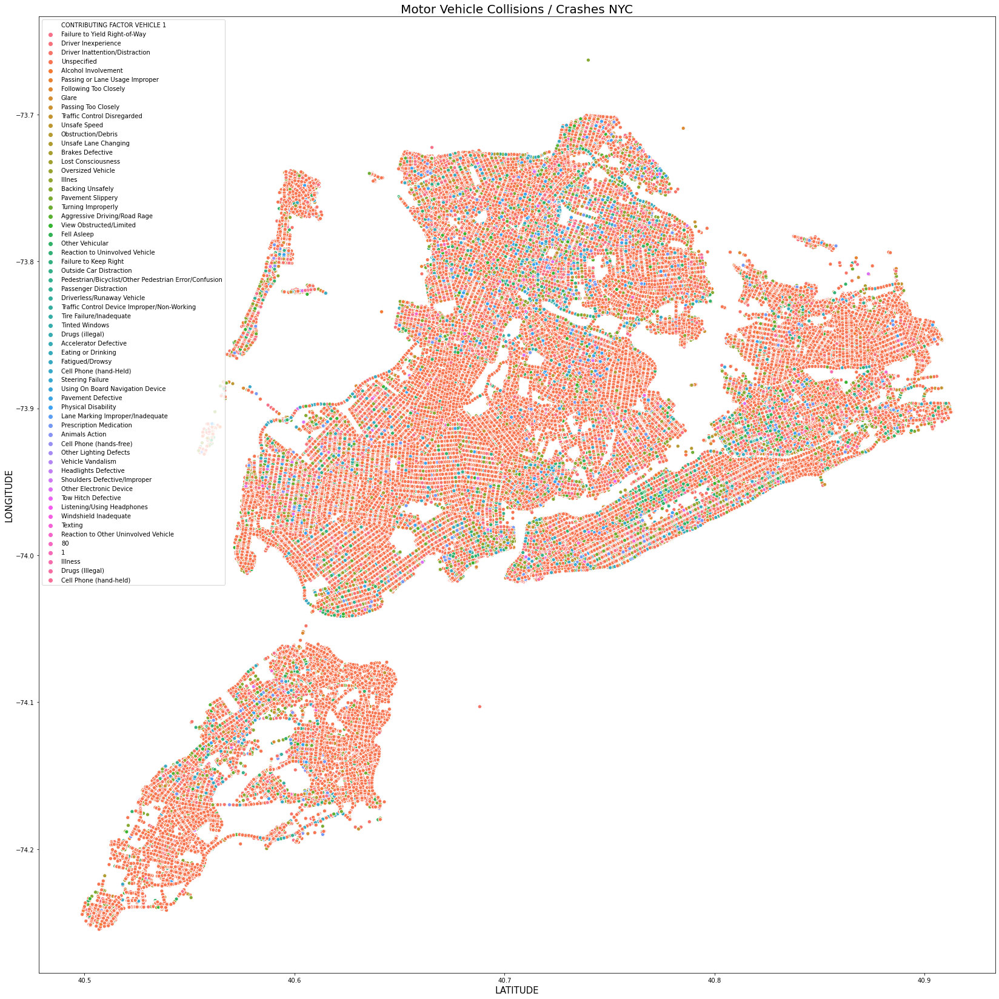

In [94]:
plt.figure(figsize = (23,23))
sns.scatterplot(data = df_clean, x = 'LATITUDE', y = 'LONGITUDE', hue = 'CONTRIBUTING FACTOR VEHICLE 1')
plt.xlabel('LATITUDE', size=15)
plt.ylabel('LONGITUDE', size=15)
plt.title("Motor Vehicle Collisions / Crashes NYC", size=20)
plt.tight_layout()

plt.savefig("./images/scatter_Motor_Vehicle_Collisions", dpi=150)

In [ ]:
plt.figure(figsize = (23,23))
sns.scatterplot(data = df_clean, x = 'LATITUDE', y = 'LONGITUDE', hue = 'TIME HR', palette = 'BuPu')
plt.xlabel('LATITUDE', size=15)
plt.ylabel('LONGITUDE', size=15)
plt.title("Crashs per Hour @ LAT & LONG ", size=20)
plt.tight_layout()

plt.savefig("./images/scatter_byHOUR_Collisions", dpi=150)

Failure to Yield Right-of-Way
1
Driver Inexperience
2
Driver Inattention/Distraction
3
Unspecified
4
Alcohol Involvement
5
Passing or Lane Usage Improper
6
Following Too Closely
7
Passing Too Closely
8
Traffic Control Disregarded
9
Unsafe Speed
10
Unsafe Lane Changing
11
Lost Consciousness
12
Backing Unsafely
13
Pavement Slippery
14
Turning Improperly
15
Other Vehicular
16
Reaction to Uninvolved Vehicle
17
Fatigued/Drowsy
18
Prescription Medication
19


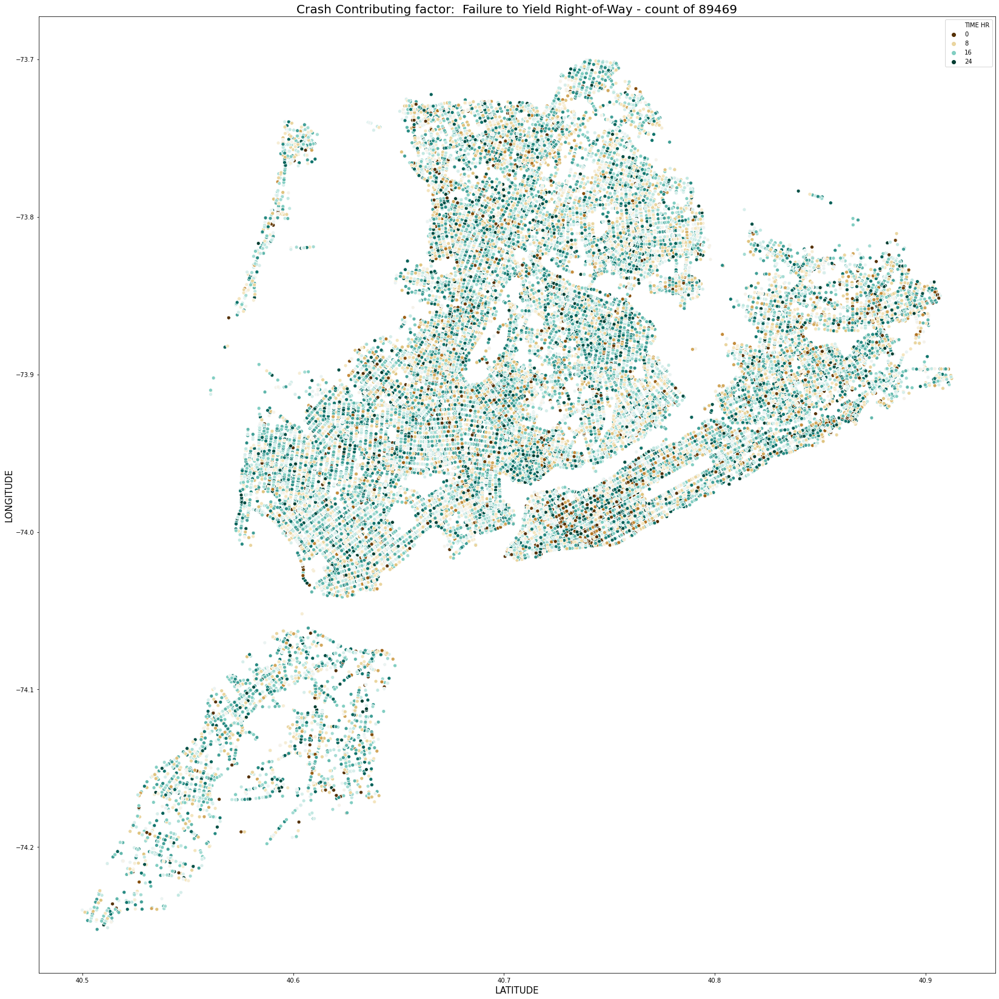

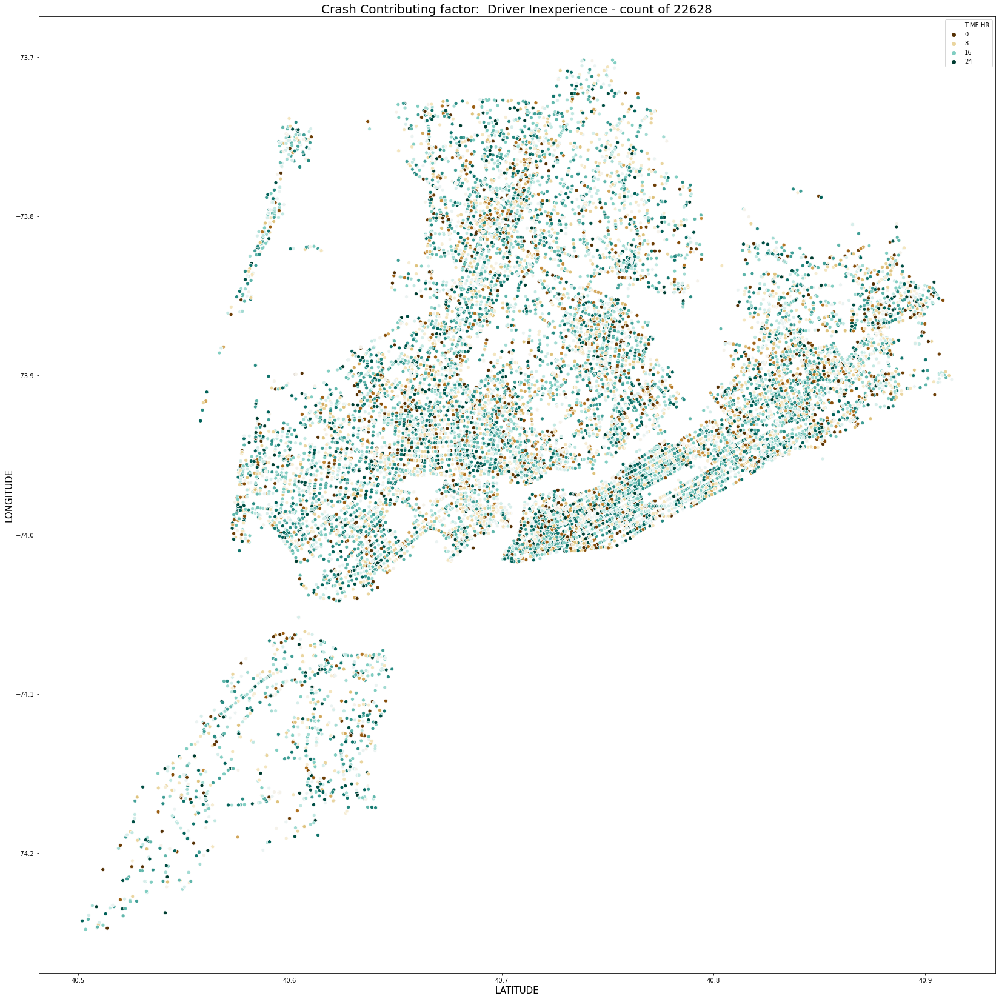

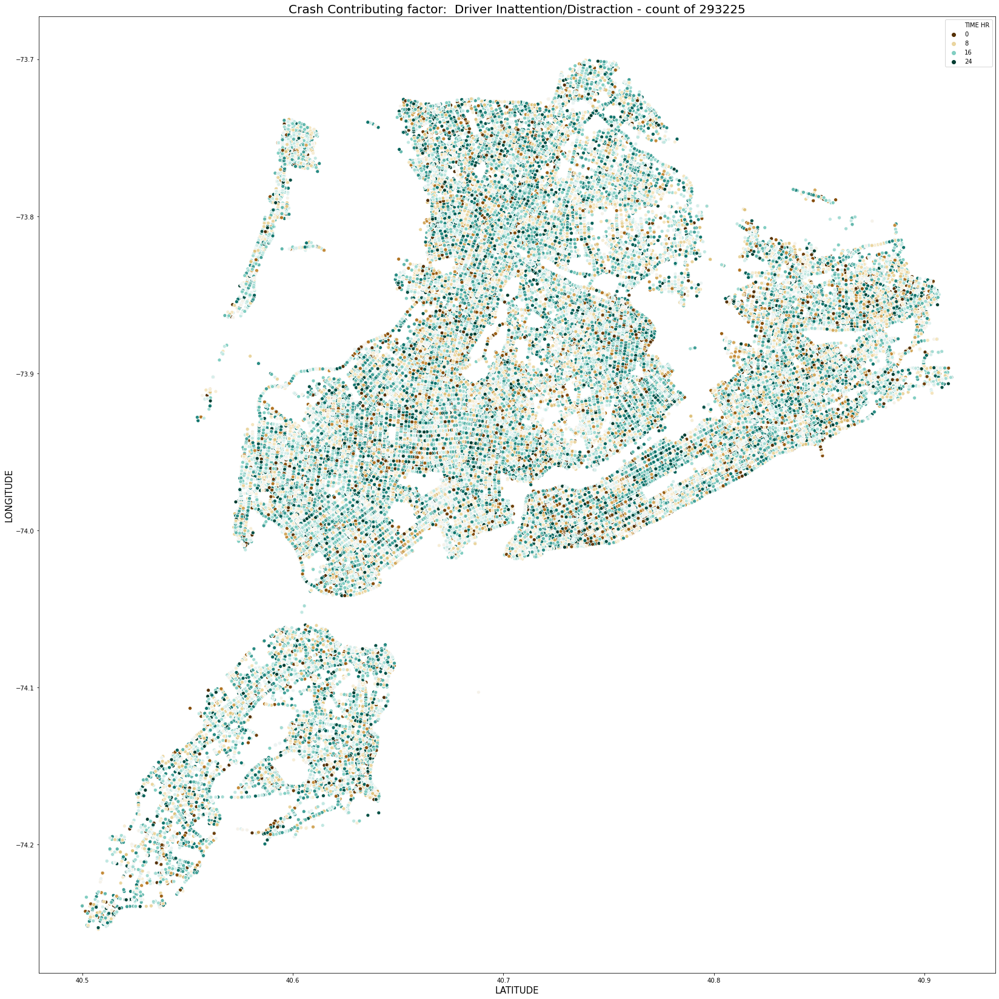

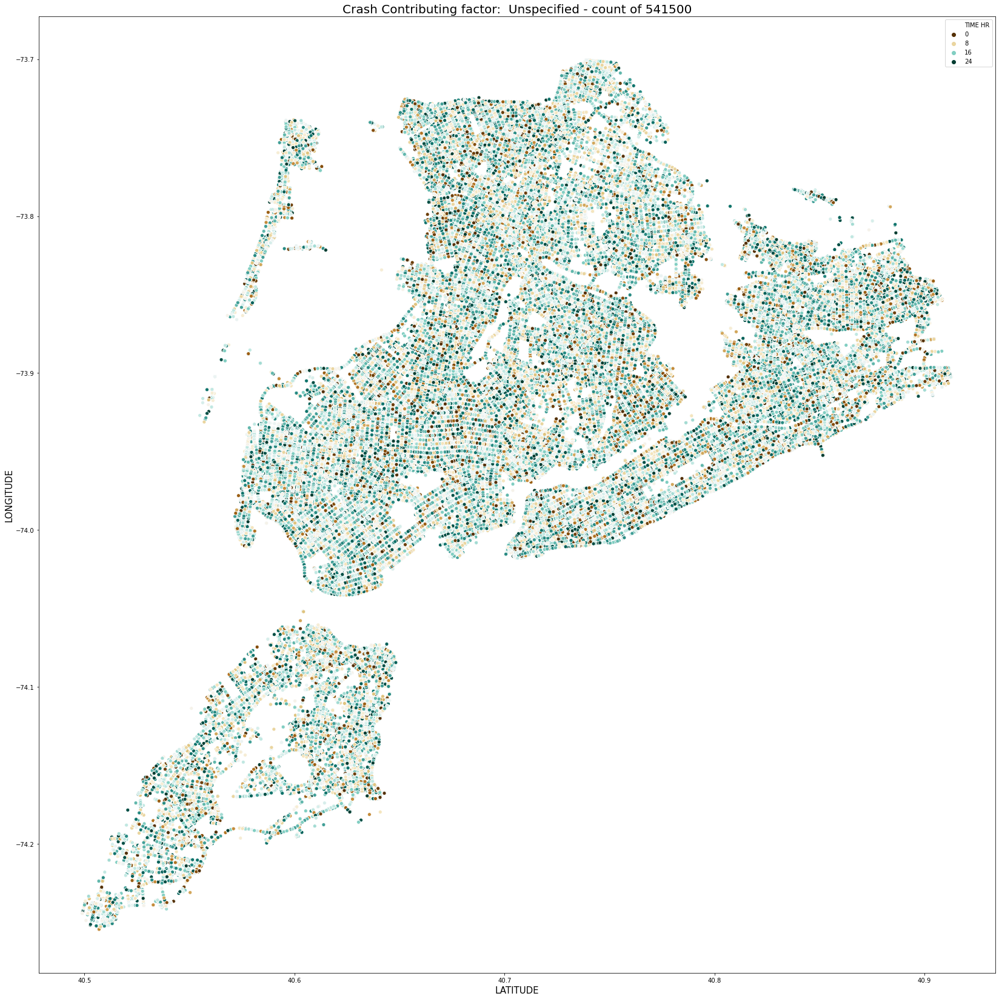

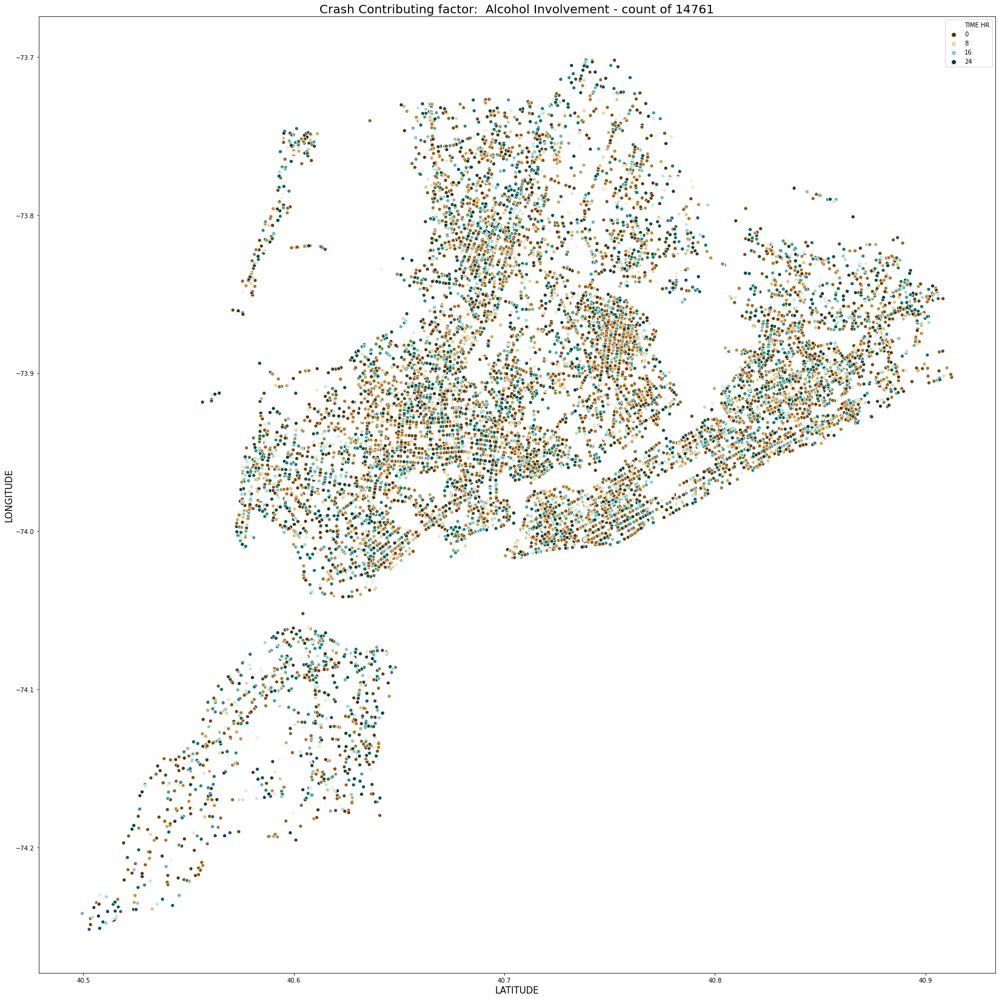

...

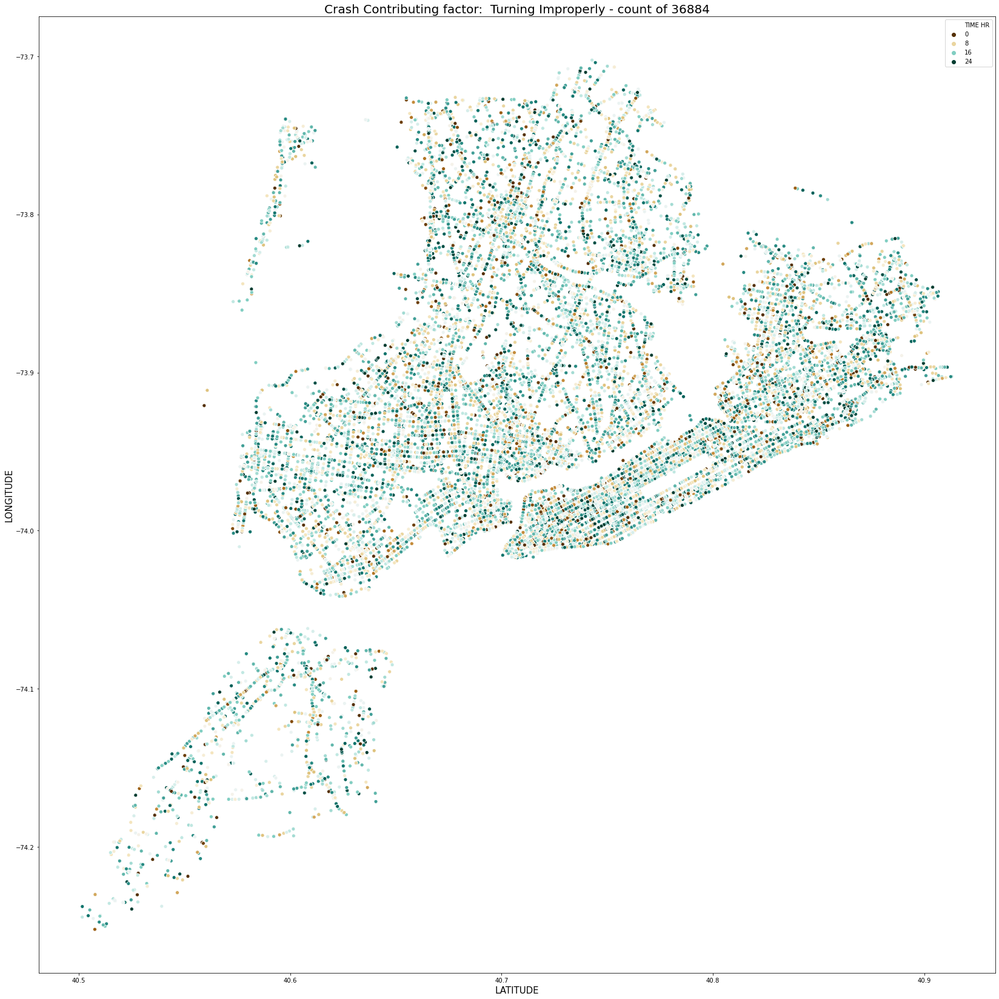

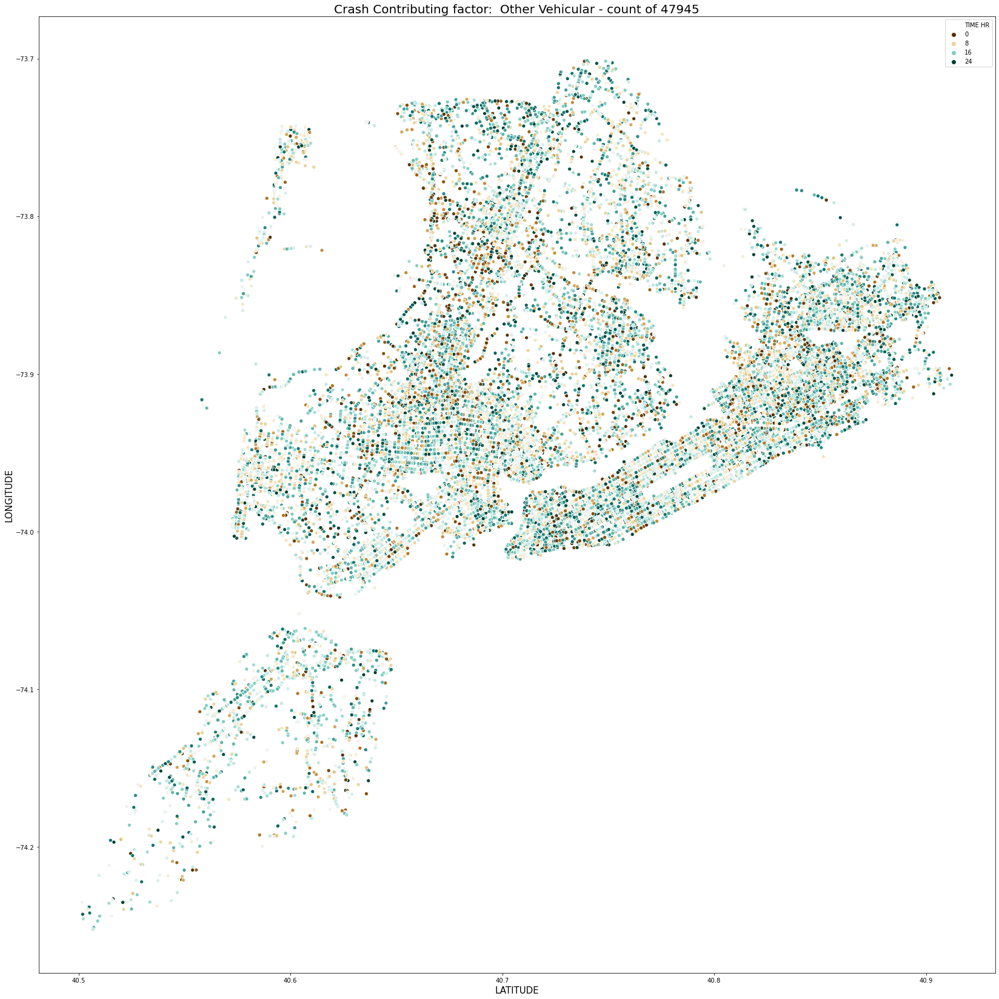

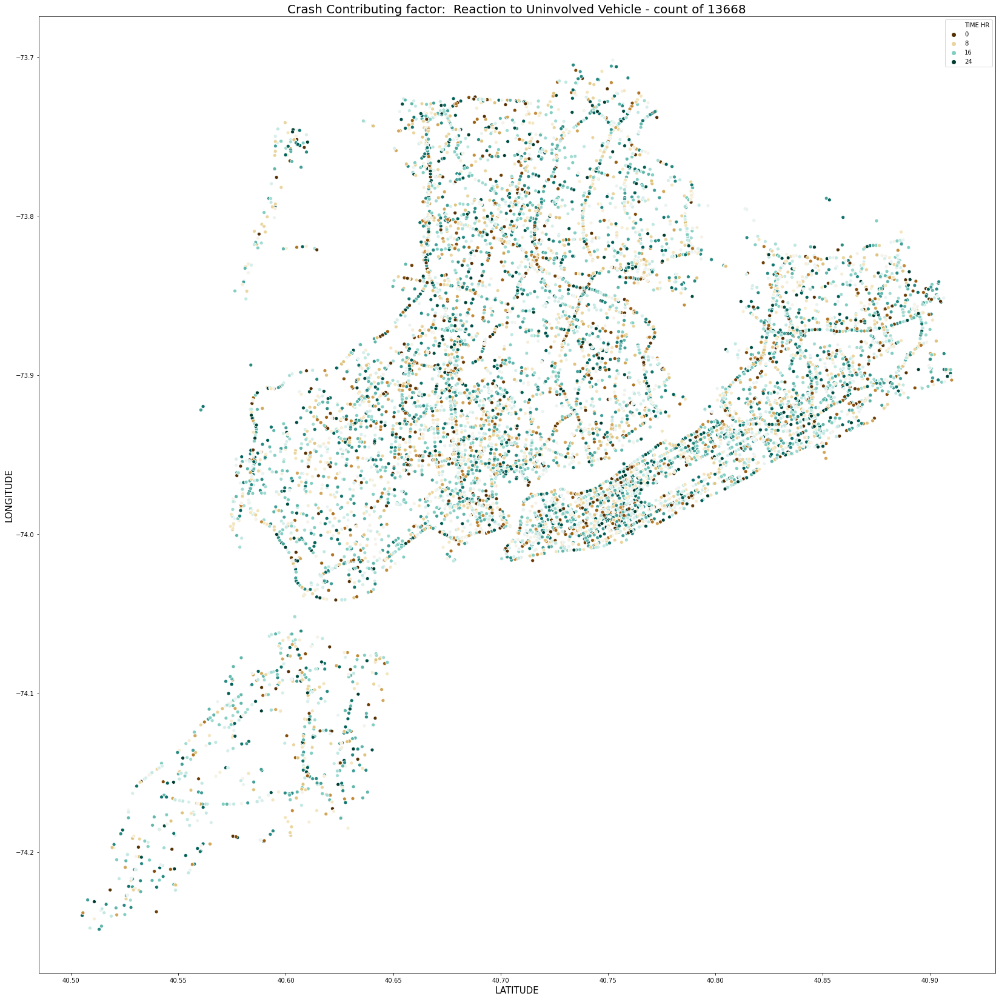

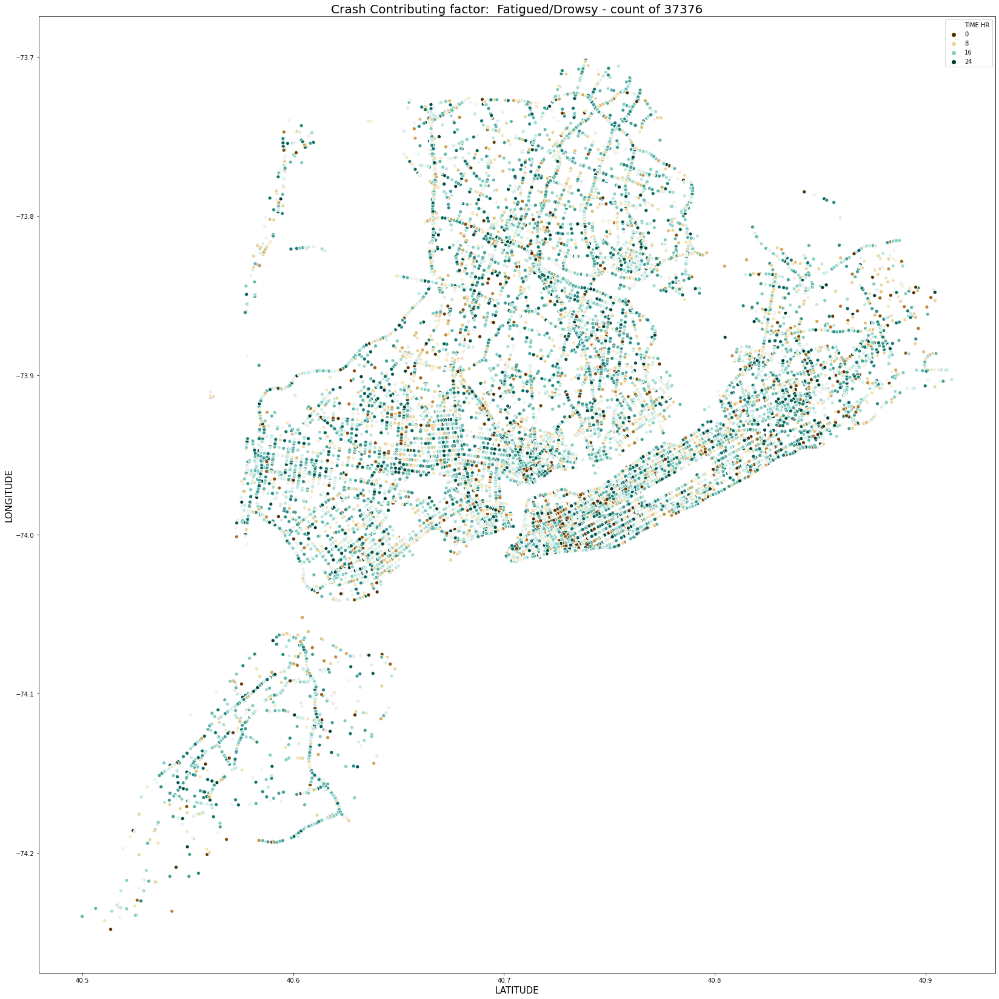

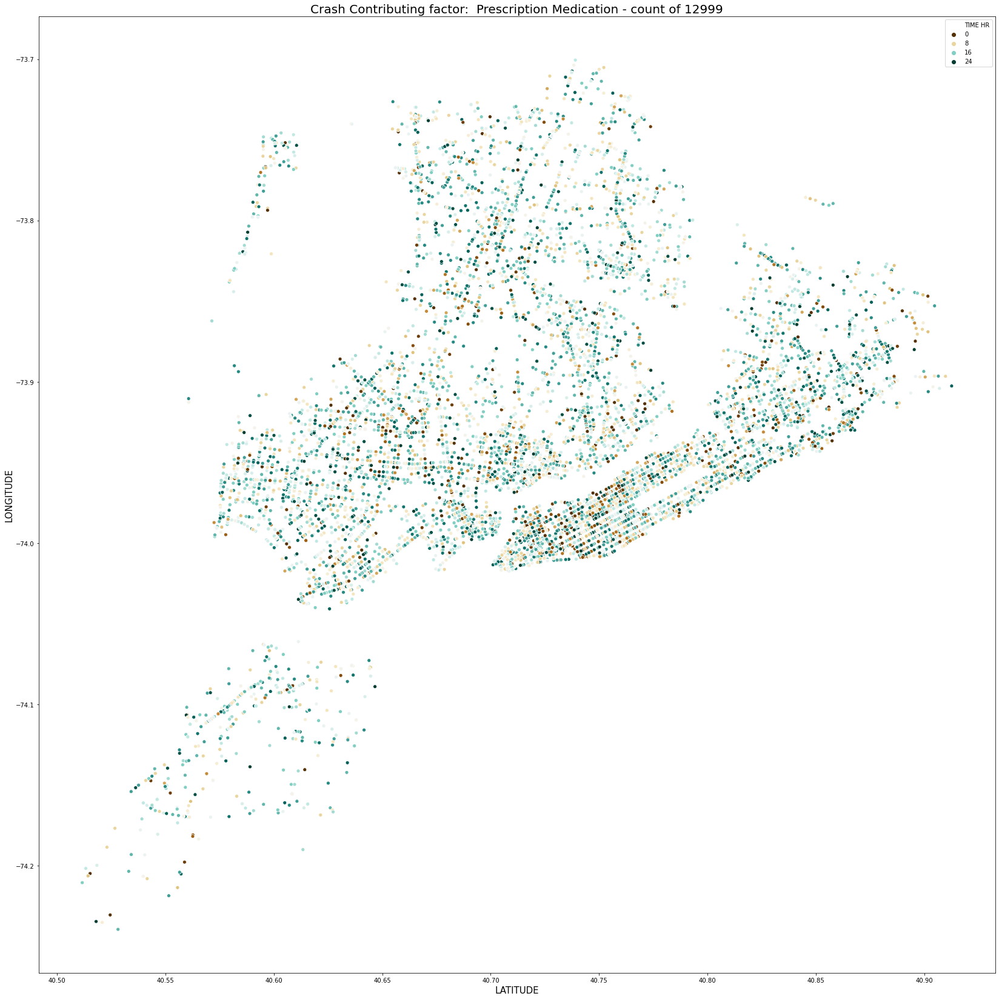

In [80]:
"""
    Prints graphs of the different contributing factors of vehicle crashes
    Graphs factors over a 10_000 count

"""
contributting_factor_list = df_clean['CONTRIBUTING FACTOR VEHICLE 1'].unique()[1:]
contributting_factor_list

c = 0
for factor in contributting_factor_list:
    
    #print(df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == factor)])
    #print(df_forloop)
    
    if df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == factor)]['TIME HR'].count() > 10_000: 
        df_forloop = df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == factor)]
        number_of_reported = df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == factor)]['TIME HR'].count()
        print(factor)
        c += 1
       
    
    # Ploting 
        plt.figure(figsize = (23,23))
        sns.scatterplot(data = df_forloop, x = 'LATITUDE', y = 'LONGITUDE', hue = 'TIME HR', palette = 'BrBG')
        plt.xlabel('LATITUDE', size=15)
        plt.ylabel('LONGITUDE', size=15)
        plt.title(f"Crash Contributing factor:  {factor} - count of {number_of_reported}", size=20)
        plt.tight_layout()
    # 
        print(c)
        plt.savefig('./images/contrib_factor_' + str(c), dpi=150)

# BELOW THIS LINE IS ALL SCRAtCH

--- 

---

--- 

## Create a clean DataFrame for EDA

In [90]:
"""
    Creating reduced colums 

"""
# list of columns names

columns_names = list(df.columns)

#removing names of columns you want to KEEP

columns_names.remove('LATITUDE')
columns_names.remove('LONGITUDE')
columns_names.remove('CONTRIBUTING FACTOR VEHICLE 1')
columns_names.remove('CRASH TIME')
columns_names.remove('CRASH DATE')
#dropping the rest of the list 

#df_clean = df_clean.drop(columns = columns_names, axis = 1)

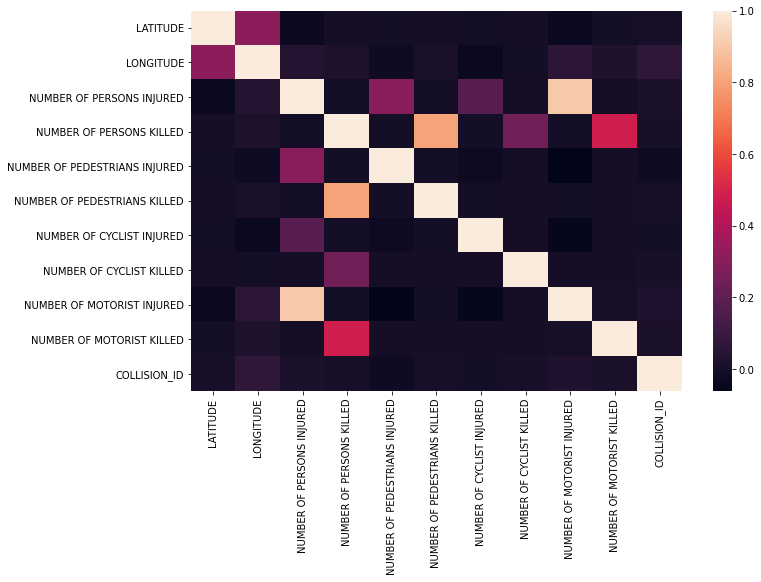

In [69]:
plt.figure(figsize = (11,7))
sns.heatmap(df_corr.corr());

#### Create Features

In [70]:
# Drops minuets in time to create a hourly report of the crashes 

df_clean['TIME HR'] = [time.split(':')[0] for time in df_clean['CRASH TIME'] ]

### Graphing 

In [72]:
df_clean.groupby('CONTRIBUTING FACTOR VEHICLE 1').count()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,TIME HR
CONTRIBUTING FACTOR VEHICLE 1,,,,,,,,,,,,,,,,,,,,,
1,5,5,3,3,5,5,5,0,0,5,...,0,0,0,5,5,4,0,0,0,5
80,62,62,46,46,62,62,62,12,7,48,...,5,1,0,62,62,35,5,1,0,62
Accelerator Defective,736,736,600,600,736,736,736,503,422,208,...,187,62,19,736,735,565,183,60,18,736
Aggressive Driving/Road Rage,6143,6143,4508,4508,6143,6143,6143,4826,3665,1095,...,928,309,119,6143,6062,4804,873,288,111,6143
Alcohol Involvement,14761,14761,11255,11252,14761,14761,14761,11427,9112,2827,...,3471,1366,524,14761,14712,12200,3445,1353,519,14761
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Unspecified,541500,541500,465622,465567,541500,541500,541500,446394,408541,71024,...,27028,5443,1346,541500,539743,421367,27045,5441,1350,541500
Using On Board Navigation Device,90,90,45,45,90,90,90,81,40,9,...,7,1,1,90,90,71,7,1,1,90
Vehicle Vandalism,84,84,63,63,84,84,84,51,35,33,...,10,2,1,84,82,58,9,2,1,84


In [73]:
df_clean

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,TIME HR
0,10/09/2020,10:12,NaN,NaN,40.683933,-73.871190,"(40.683933, -73.87119)",HEMLOCK STREET,NaN,NaN,...,NaN,NaN,NaN,4356254,NaN,NaN,NaN,NaN,NaN,10
3,10/08/2020,10:46,NaN,NaN,40.827210,-73.920700,"(40.82721, -73.9207)",EAST 162 STREET,NaN,NaN,...,NaN,NaN,NaN,4355967,Sedan,AMBU,NaN,NaN,NaN,10
4,10/08/2020,19:24,NaN,NaN,40.799310,-73.943245,"(40.79931, -73.943245)",PARK AVENUE,NaN,NaN,...,NaN,NaN,NaN,4356130,Sedan,NaN,NaN,NaN,NaN,19
6,10/06/2020,17:00,QUEENS,11413,40.668840,-73.743880,"(40.66884, -73.74388)",NaN,NaN,139-36 230 PLACE,...,NaN,NaN,NaN,4355303,Sedan,NaN,NaN,NaN,NaN,17
7,10/06/2020,19:24,NaN,NaN,40.826530,-73.946670,"(40.82653, -73.94667)",AMSTERDAM AVENUE,NaN,NaN,...,NaN,NaN,NaN,4355381,NaN,NaN,NaN,NaN,NaN,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1720017,07/06/2012,9:03,NaN,NaN,40.715796,-73.815664,"(40.7157964, -73.815664)",NaN,NaN,NaN,...,NaN,NaN,NaN,3033154,UNKNOWN,PASSENGER VEHICLE,NaN,NaN,NaN,9
1720018,07/05/2012,20:30,QUEENS,11372,40.756538,-73.876067,"(40.7565375, -73.8760673)",92 STREET,NORTHERN BOULEVARD,NaN,...,NaN,NaN,NaN,279675,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,20
1720019,07/02/2012,8:50,STATEN ISLAND,10314,40.612808,-74.126292,"(40.6128076, -74.1262915)",NaN,NaN,P/L 1872 VICTORY BLVD,...,NaN,NaN,NaN,284653,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,8
1720020,07/06/2012,14:00,BROOKLYN,11222,40.724057,-73.949924,"(40.724057, -73.9499244)",NASSAU AVENUE,LEONARD STREET,NaN,...,NaN,NaN,NaN,198181,PASSENGER VEHICLE,BICYCLE,NaN,NaN,NaN,14


In [74]:
df_clean

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,TIME HR
0,10/09/2020,10:12,NaN,NaN,40.683933,-73.871190,"(40.683933, -73.87119)",HEMLOCK STREET,NaN,NaN,...,NaN,NaN,NaN,4356254,NaN,NaN,NaN,NaN,NaN,10
3,10/08/2020,10:46,NaN,NaN,40.827210,-73.920700,"(40.82721, -73.9207)",EAST 162 STREET,NaN,NaN,...,NaN,NaN,NaN,4355967,Sedan,AMBU,NaN,NaN,NaN,10
4,10/08/2020,19:24,NaN,NaN,40.799310,-73.943245,"(40.79931, -73.943245)",PARK AVENUE,NaN,NaN,...,NaN,NaN,NaN,4356130,Sedan,NaN,NaN,NaN,NaN,19
6,10/06/2020,17:00,QUEENS,11413,40.668840,-73.743880,"(40.66884, -73.74388)",NaN,NaN,139-36 230 PLACE,...,NaN,NaN,NaN,4355303,Sedan,NaN,NaN,NaN,NaN,17
7,10/06/2020,19:24,NaN,NaN,40.826530,-73.946670,"(40.82653, -73.94667)",AMSTERDAM AVENUE,NaN,NaN,...,NaN,NaN,NaN,4355381,NaN,NaN,NaN,NaN,NaN,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1720017,07/06/2012,9:03,NaN,NaN,40.715796,-73.815664,"(40.7157964, -73.815664)",NaN,NaN,NaN,...,NaN,NaN,NaN,3033154,UNKNOWN,PASSENGER VEHICLE,NaN,NaN,NaN,9
1720018,07/05/2012,20:30,QUEENS,11372,40.756538,-73.876067,"(40.7565375, -73.8760673)",92 STREET,NORTHERN BOULEVARD,NaN,...,NaN,NaN,NaN,279675,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,20
1720019,07/02/2012,8:50,STATEN ISLAND,10314,40.612808,-74.126292,"(40.6128076, -74.1262915)",NaN,NaN,P/L 1872 VICTORY BLVD,...,NaN,NaN,NaN,284653,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,8
1720020,07/06/2012,14:00,BROOKLYN,11222,40.724057,-73.949924,"(40.724057, -73.9499244)",NASSAU AVENUE,LEONARD STREET,NaN,...,NaN,NaN,NaN,198181,PASSENGER VEHICLE,BICYCLE,NaN,NaN,NaN,14


In [81]:
# created to orginze
df_clean['v_factor_1'] = df_clean['CONTRIBUTING FACTOR VEHICLE 1']

In [83]:
df_clean.v_factor_1.value_counts()

Unspecified                       541500
Driver Inattention/Distraction    293225
Failure to Yield Right-of-Way      89469
Following Too Closely              76302
Backing Unsafely                   59656
                                   ...  
Windshield Inadequate                 63
80                                    62
Texting                               35
Listening/Using Headphones            15
1                                      5
Name: v_factor_1, Length: 61, dtype: int64

In [76]:
df_clean[(df_clean['CONTRIBUTING FACTOR VEHICLE 1'] == 'Driver Inattention/Distraction')]['TIME HR'].count() 

293225